In [1]:
import matplotlib.pyplot as plt
import strauss
from strauss.sonification import Sonification
from strauss.sources import Objects
from strauss.generator import Generator
from strauss import channels
from strauss.generator import Sampler
from strauss.score import Score
from strauss.generator import Synthesizer
from strauss.sources import Events
import os
import numpy as np
import copy
import pandas as pd


# Let's do our own sonifications!

## We'll start with a 'simple' analytic function:

Text(0, 0.5, 'Y')

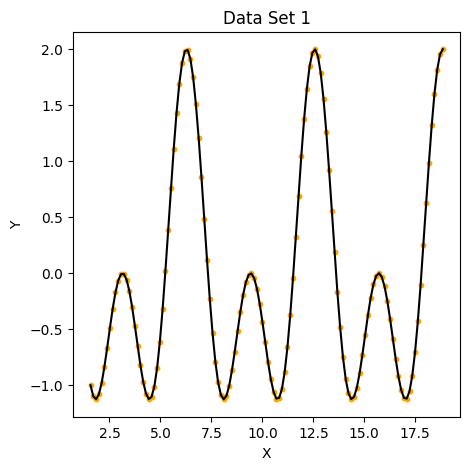

In [2]:
ds1_x = np.linspace(np.pi/2, 6*np.pi, 128)
ds1_y = np.cos(ds1_x) + np.cos(ds1_x*2)

plt.figure(figsize=(5,5))
plt.title('Data Set 1')
plt.plot(ds1_x, ds1_y, c='k')
plt.scatter(ds1_x, ds1_y, c='orange',s=10)
plt.xlabel('X')
plt.ylabel('Y')

### Next, with this curve in mind, we need to pick an instrument

In [4]:
#list out the options
Sampler('ChateauGrand-Plus-Instruments-bs16i-v4.sf2')

valid 'sf_preset' not provided for soundfont file, available presets are:

----------------------------------------
1. "Rotary Organ"
2. "Warm Pad"
3. "Steel Guitar"
4. "Nylon Guitar"
5. "Chateau Grand"
6. "Chateau Grand+Pad"
7. "Ch Grand+LowStrings"
8. "Ch Grand+Strings"
9. "Ch Grand+ChamberStr"
10. "Full Strings Vel"
11. "Chamber Strings"
12. "Cello"
13. "Rotary Slow"
14. "Rotary Fast"
15. "Rotary Var.Velocity"
16. "Small Pipe Organ"
17. "Pipe Organ Full"
18. "Plein-jeu Organ Lge"
19. "DX7 EP"
20. "Small Plein-Jeu"
21. "Flute Sml Plein-Jeu"
22. "Pad Plein-jeu Large"
23. "Flute 2"
24. "FlutePad S Plein-Jeu"
25. "Dark Chateau Grand"
26. "DX7+Pad"
27. "DX7+Low Strings"
28. "Voyager-8"
29. "Violin (all around)"
30. "Two Violins"
31. "Alto Sax"
32. "Flute Expr+8 (SSO)"
33. "Clean Guitar"
34. "Jazz Guitar"
35. "Chorus Guitar"
36. "Trumpet"
37. "Synth Strings"
38. "Full Orchestra"
39. "Banjo 5 String"
40. "Moog Pad"
41. "Moog 55 Rez"
42. "Accordion"
43. "Italian Accordion"
44. "12 String Gu

## Which instrument/number?

In [5]:
# set up sampler - grabbing specified soundfont
generator = Sampler('ChateauGrand-Plus-Instruments-bs16i-v4.sf2', sf_preset = 42) #42 is accordian!
gen1 = copy.copy(generator)
gen1.load_preset('sustain')

## Let's play a few notes to check out the sound 

<Figure size 640x480 with 0 Axes>

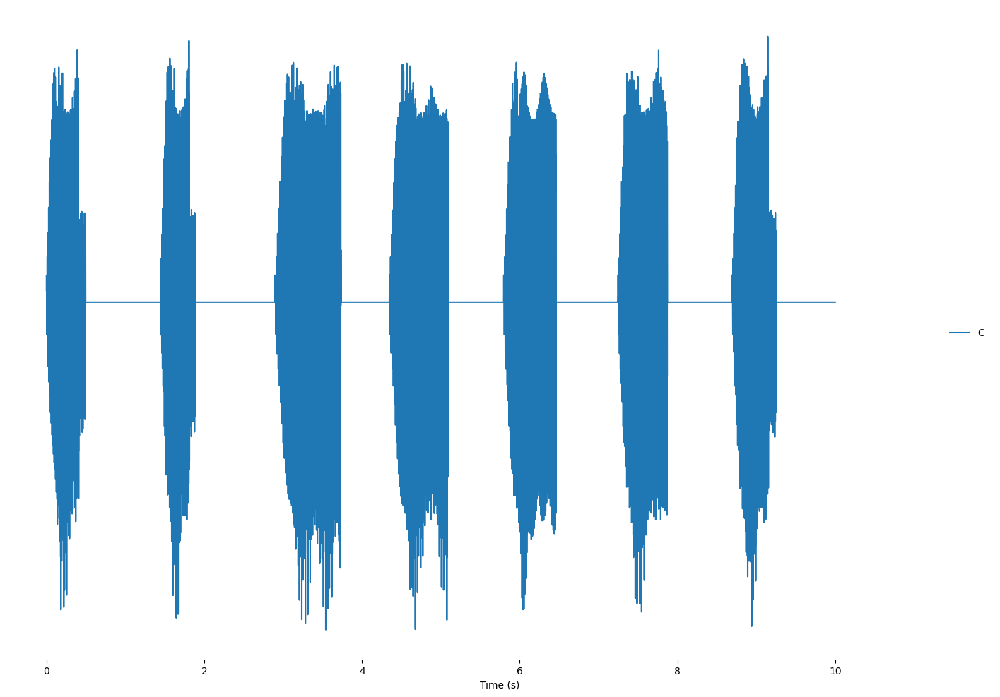

In [7]:
system = "mono" #mono = no spatial information from the sound!

# length of the sonification in seconds
length = 10

notes = [["A2"], ["B2"], ["C2"], ["D2"], ["E2"], ["F2"], ["G2"]] #let's just play notes A, B, C, D, E, F, G in the second octave
score =  Score(notes, length) #setting up the score, nothing too exciting here

data = {'pitch':np.ones(len(notes)), #pitch constant 
        'volume':np.ones(len(notes)), #volume constant
        'time':np.arange(len(notes))} #time evolves here - play each note!

maplims =  {'time': ('0%', '115%')} #time limits - needs to be a bit over 100 so that the final note can finish out

# doing the actual sonification!
sources = Events(data.keys()) 
sources.fromdict(data)
sources.apply_mapping_functions(map_lims=maplims)

soni = Sonification(score, sources, gen1, system)
soni.render()
plt.figure() 
soni.notebook_display()

# Now that we have tried just playing a few notes, lets try sonifying our curve from before. Here is the curve again:

Text(0, 0.5, 'Y')

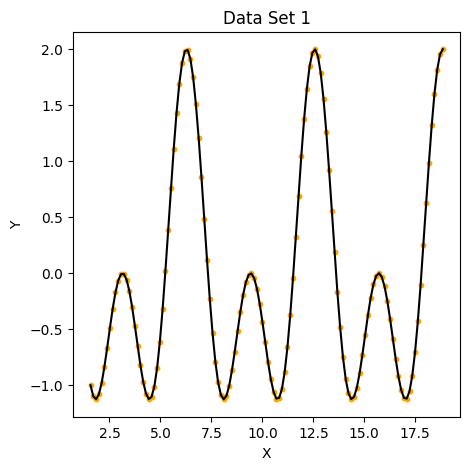

In [8]:
ds1_x = np.linspace(np.pi/2, 6*np.pi, 128)
ds1_y = np.cos(ds1_x) + np.cos(ds1_x*2)

plt.figure(figsize=(5,5))
plt.title('Data Set 1')
plt.plot(ds1_x, ds1_y, c='k')
plt.scatter(ds1_x, ds1_y, c='orange',s=10)
plt.xlabel('X')
plt.ylabel('Y')

# Now that we've picked an instrument, we need to pick what we want each variable to map to. In our simple example, we've turned off spatial (stereo) information, so our remaining options are the notes (or chords!), volume of those notes, and pitch of those notes. Let's start off by trying volume:

<Figure size 640x480 with 0 Axes>

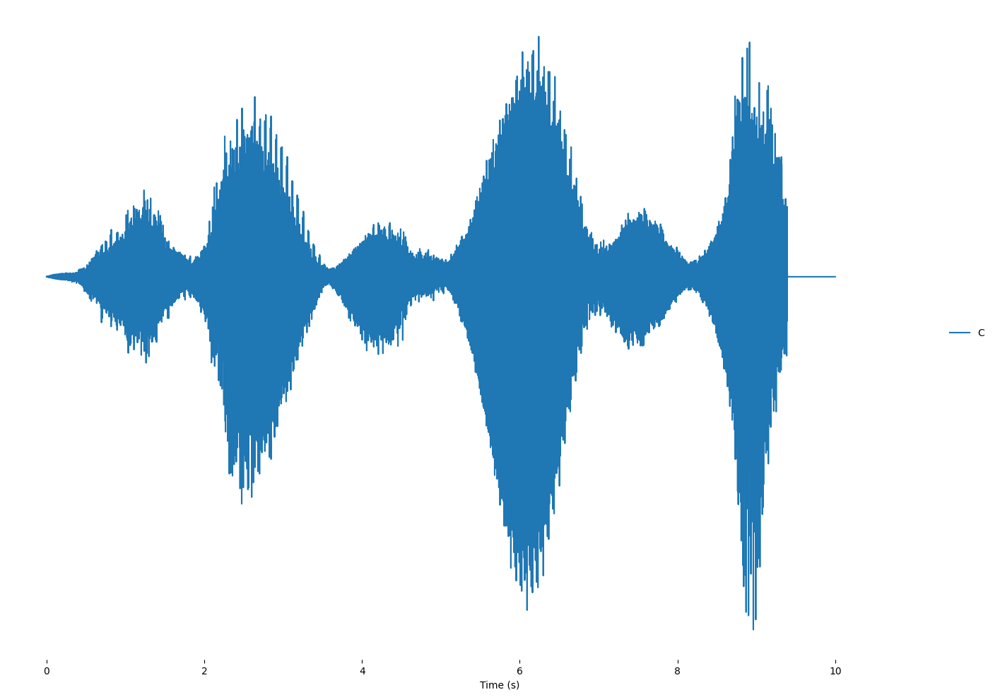

In [10]:
# specify audio system 
system = "mono" #mono = no spatial information from the sound!

# length of the sonification in seconds
length = 10

notes = [["C2", "E2", "G2"]] #lets pick a chord! this is C-major
score =  Score(notes, length) #setting up the score, nothing too exciting here

y_all_positive = ds1_y+abs(np.min(ds1_y)) #remember that some of our y values are negative, but we want only positive volume!

data = {'pitch':np.ones(len(ds1_y)), #pitch constant 
        'volume': y_all_positive/np.max(y_all_positive), #volume is given as a fraction of maximum, so 0->1
        'time':np.linspace(0, 1, len(ds1_x))} #time evolves with x here

maplims =  {'time': ('0%', '115%')} #time limits - needs to be a bit over 100 so that the final note can finish out

# doing the actual sonification!
sources = Events(data.keys()) 
sources.fromdict(data)
sources.apply_mapping_functions(map_lims=maplims)

soni = Sonification(score, sources, gen1, system)
soni.render()
plt.figure()
soni.notebook_display()

# Now let's try pitch!

<Figure size 640x480 with 0 Axes>

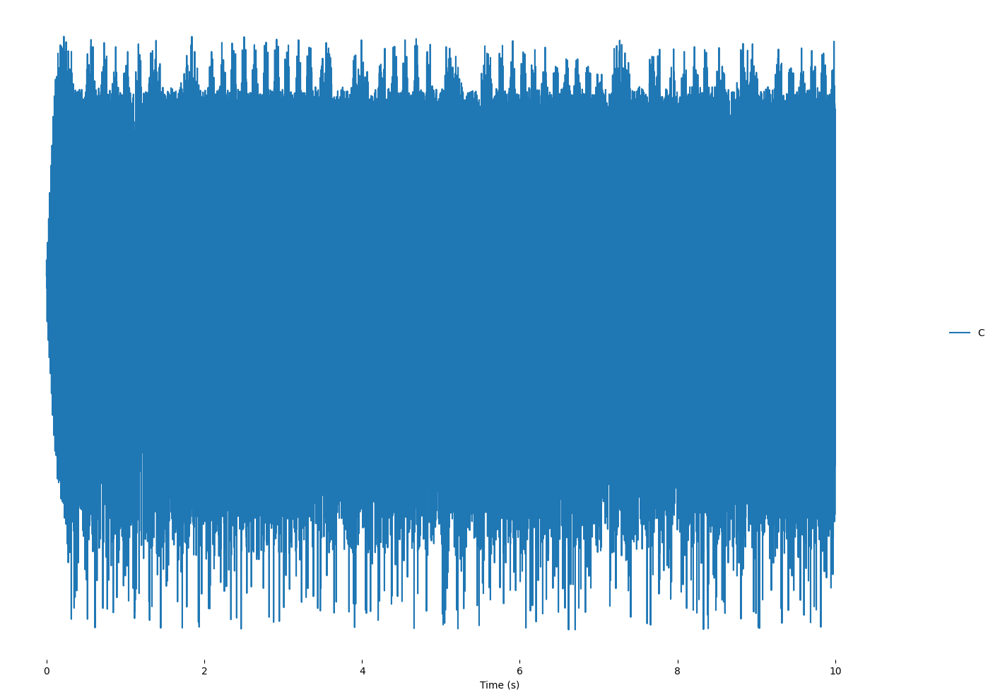

In [11]:
# length of the sonification in seconds
length = 10

notes = [["C2", "E2", "G2"]] #what notes do you want? Do you want a chord?
score =  Score(notes, length) #setting up the score, nothing too exciting here


data = {'pitch_shift':y_all_positive, #pitch constant
        'pitch':1,
        'time_evo':np.linspace(0, 1, len(ds1_x))} 

maplims =  {'time': ('0%', '115%')} #time limits - needs to be a bit over 100 so that the final note can finish out

# doing the actual sonification!
sources = Objects(data.keys()) 
sources.fromdict(data)
sources.apply_mapping_functions(map_lims=maplims)

soni = Sonification(score, sources, gen1, system)
soni.render()
plt.figure()
soni.notebook_display()

# Hmmm... that sounds kind of funky. The sound is coming from a recording of our chosen instrument, and when instruments make a note there's some decay time (a 'sound envelope'). What we're hearing is the uneven evolution in time of our note getting really wonky! Let's try with a synthetic sound wave:

<Figure size 640x480 with 0 Axes>

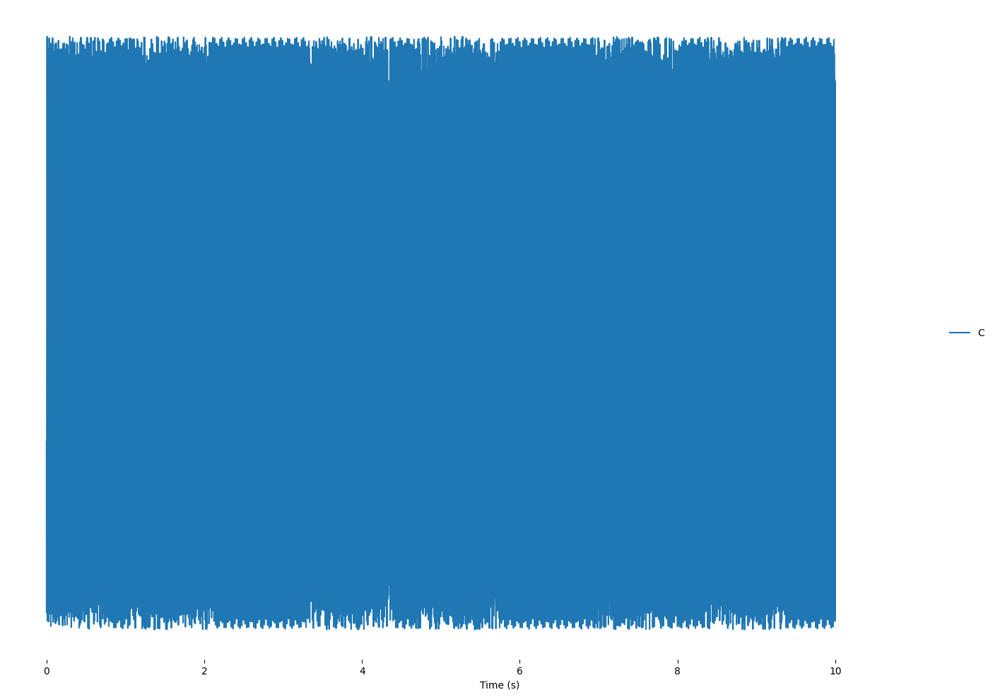

In [13]:
# specify audio system 
gen2 = Synthesizer() #now we use a synthesizer
gen2.load_preset('pitch_mapper') # with some presets
gen2.modify_preset({'filter':'on'}) #and a cap on the frequencies so we don't make awful sounds


# length of the sonification in seconds
length = 10

notes = [["C2", "E2", "G2"]] #what notes do you want? Do you want a chord?
score =  Score(notes, length) #setting up the score, nothing too exciting here


data = {'pitch_shift':y_all_positive, #pitch constant
        'pitch':1,
        'time_evo':np.linspace(0, 1, len(ds1_x))} 

maplims =  {'time': ('0%', '115%')} #time limits - needs to be a bit over 100 so that the final note can finish out

# doing the actual sonification!
sources = Objects(data.keys()) 
sources.fromdict(data)
sources.apply_mapping_functions(map_lims=maplims)

soni = Sonification(score, sources, gen2, system)
soni.render()
plt.figure()
soni.notebook_display()

# Another option is whether the sound is discrete or continuous. Do we play the note and modulate that, or do we hit the note each time there is a point on (e.g.) the x-axis? Above we are using a continuous note, but in the next example, we will make it discrete

<Figure size 640x480 with 0 Axes>

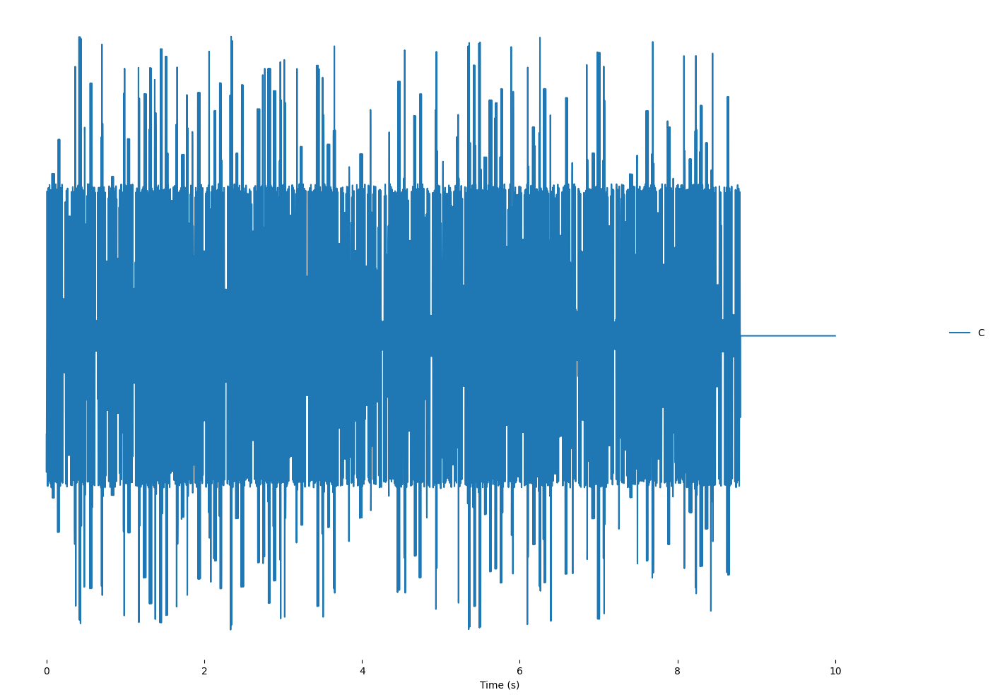

In [14]:
# length of the sonification in seconds
length = 10

notes = [["C2", "E2", "G2", "Bb2", "D2"]] #if you pass in a chord with more notes, there's more range for the pitch to map to!
#this is a c9 chord
score =  Score(notes, length) #setting up the score, nothing too exciting here


data = {'pitch': y_all_positive/np.max(y_all_positive), #pitch changes with y-axis
        'time':np.linspace(0, 1, len(ds1_x))} 

maplims =  {'time': ('0%', '115%')} #time limits - needs to be a bit over 100 so that the final note can finish out

# doing the actual sonification!
sources = Events(data.keys()) 
sources.fromdict(data)
sources.apply_mapping_functions(map_lims=maplims)

soni = Sonification(score, sources, gen2, system)
soni.render()
plt.figure()
soni.notebook_display()

# Your turn! Let's break into groups and discuss ways that we could sonify this data:

In [16]:
#lets read in the air quality data from NYC open data: https://data.cityofnewyork.us/Environment/Air-Quality/c3uy-2p5r/about_data
air = pd.read_csv('Air_Quality_20250324.csv')

## This data set is real air quality data from various areas in NYC, available through NYC OpenData. There are a handful of different columns, we'll look at the annual mean measurement of fine particles (those less than 2.5 micrometers in diameter, measured in microgram per cubic meter) and the annual mean measurement of Nitrogen Dioxide (NO2, measured in parts per billion) in Manhattan overall. Both of these measurements are tracking pollutants in the air

In [17]:
print('this data set has these columns:', air.columns)

this data set has these columns: Index(['Unique ID', 'Indicator ID', 'Name', 'Measure', 'Measure Info',
       'Geo Type Name', 'Geo Join ID', 'Geo Place Name', 'Time Period',
       'Start_Date', 'Data Value', 'Message'],
      dtype='object')


In [18]:
#collecting the relevant data and sorting by collection date
pm25 = air[(air['Geo Place Name']=='Manhattan')&(air['Measure']=='Mean')&(air['Indicator ID']==365)&\
                (air['Time Period'].str.contains('Annual'))].sort_values(by='Time Period')
no2 = air[(air['Geo Place Name']=='Manhattan')&(air['Measure']=='Mean')&(air['Indicator ID']==375)&\
                (air['Time Period'].str.contains('Annual'))].sort_values(by='Time Period')

[Text(0.5, 0, 'Start Date'), Text(0, 0.5, 'NO2, Parts Per Billion')]

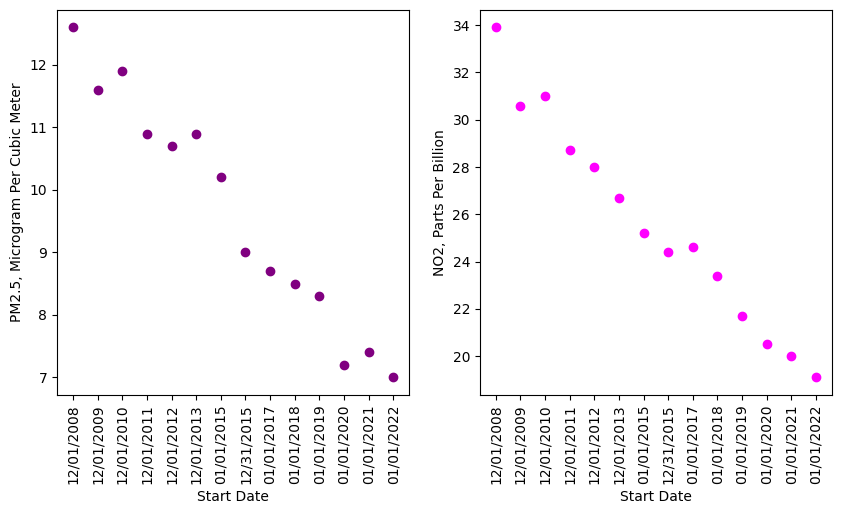

In [19]:
fig, (ax) = plt.subplot_mosaic([['A', 'B']], figsize=(10,5))
#plt.subplot_mosaic([['A', 'A', 'A', 'B', 'B', 'B']], figsize=(10,5))
ax['A'].scatter(pm25['Start_Date'], pm25['Data Value'], c='purple')
ax['A'].tick_params(axis='x', labelrotation=90)
ax['A'].set(xlabel='Start Date', ylabel='PM2.5, Microgram Per Cubic Meter')

ax['B'].scatter(no2['Start_Date'], no2['Data Value'], c='magenta')
ax['B'].tick_params(axis='x', labelrotation=90)
ax['B'].set(xlabel='Start Date', ylabel='NO2, Parts Per Billion')

Some choices that you can make:
- PM2.5 or NO2?
- instrument vs synth (timbre)
- mapping pitch vs volume
- discrete vs continuous
- the note (or chord) to be modulated

A resource to help pick notes/chords: https://www.musicca.com/piano

If we were using a different setup, we could also change instruments! Unfortunately, this is a bit too tricky with current setup to do on-the-fly

(Reminder of the instruments that we can choose from:
1. "Rotary Organ"
2. "Warm Pad"
3. "Steel Guitar"
4. "Nylon Guitar"
5. "Chateau Grand"
6. "Chateau Grand+Pad"
7. "Ch Grand+LowStrings"
8. "Ch Grand+Strings"
9. "Ch Grand+ChamberStr"
10. "Full Strings Vel"
11. "Chamber Strings"
12. "Cello"
13. "Rotary Slow"
14. "Rotary Fast"
15. "Rotary Var.Velocity"
16. "Small Pipe Organ"
17. "Pipe Organ Full"
18. "Plein-jeu Organ Lge"
19. "DX7 EP"
20. "Small Plein-Jeu"
21. "Flute Sml Plein-Jeu"
22. "Pad Plein-jeu Large"
23. "Flute 2"
24. "FlutePad S Plein-Jeu"
25. "Dark Chateau Grand"
26. "DX7+Pad"
27. "DX7+Low Strings"
28. "Voyager-8"
29. "Violin (all around)"
30. "Two Violins"
31. "Alto Sax"
32. "Flute Expr+8 (SSO)"
33. "Clean Guitar"
34. "Jazz Guitar"
35. "Chorus Guitar"
36. "Trumpet"
37. "Synth Strings"
38. "Full Orchestra"
39. "Banjo 5 String"
40. "Moog Pad"
41. "Moog 55 Rez"
42. "Accordion"
43. "Italian Accordion"
44. "12 String Guitar"
45. "Distortion Guitar"
46. "Steel Low Vel Mute"
47. "Steel Layered Mute"
48. "Saw Wave"
49. "Single Coil FX"
50. "LP Twin Elec Gtr"
51. "Single Coil FX Pick"
52. "LP Twin Pick Gtr"
53. "Distn Gtr Pick"
54. "Single Coil Dry"
55. "LP Twin Muted"
56. "Single Coil Muted"
57. "Jazz Guitar 2"
58. "Overdrive Guitar"
59. "Overdrive Gtr Pick"
60. "Jazz Guitar 3"
61. "Chateau Grand (copy)"
62. "DX7 EP (copy)"
63. "DynamicChateau(copy)"
64. "Dyn Ch+Pad"
65. "Dyn Ch+Low Strings"
66. "Dyn Ch+ChamberStr"
67. "Dyn Ch+Strings"
68. "Dynamic ChateauGrand"
69. "Studio Chateau Grand"
70. "Wurlitzer EP"
71. "Rhodes EP"
72. "Rhodes Slow Trem"
73. "Rhodes Med Trem"
74. "Rhodes Fast Trem"
75. "Rhodes Bell EP"
76. "Rhodes Bell Slow Trm"
77. "Rhodes Bell Fast Trm")

In [20]:
# Instrument or synth?
gen3 = Synthesizer() #now we use a synthesizer
gen3.load_preset('pitch_mapper') # with some presets
gen3.modify_preset({'filter':'on'}) #and a cap on the frequencies so we don't make awful sounds

#generator = Sampler('ChateauGrand-Plus-Instruments-bs16i-v4.sf2', sf_preset=31) #42 is accordian!
#gen3 = copy.copy(generator)
#gen3.load_preset('sustain')

In [21]:
# we can test out our chosen instrument/synth:
'''notes = [["A2"], ["B2"], ["C2"], ["D2"], ["E2"], ["F2"], ["G2"]] #let's just play notes A, B, C, D, E, F, G in the second octave
score =  Score(notes, length=20) #setting up the score, nothing too exciting here

data = {'pitch':np.ones(len(notes)), #pitch constant 
        'volume':np.ones(len(notes)), #volume constant
        'time':np.arange(len(notes))} #time evolves here - play each note!

maplims =  {'time': ('0', '115')} #time limits - needs to be a bit over 100 so that the final note can finish out

# doing the actual sonification!
sources = Events(data.keys()) 
sources.fromdict(data)
sources.apply_mapping_functions(map_lims=maplims)

soni = Sonification(score, sources, gen3, system)
soni.render()
plt.figure()
soni.notebook_display()'''

'notes = [["A2"], ["B2"], ["C2"], ["D2"], ["E2"], ["F2"], ["G2"]] #let\'s just play notes A, B, C, D, E, F, G in the second octave\nscore =  Score(notes, length=20) #setting up the score, nothing too exciting here\n\ndata = {\'pitch\':np.ones(len(notes)), #pitch constant \n        \'volume\':np.ones(len(notes)), #volume constant\n        \'time\':np.arange(len(notes))} #time evolves here - play each note!\n\nmaplims =  {\'time\': (\'0\', \'115\')} #time limits - needs to be a bit over 100 so that the final note can finish out\n\n# doing the actual sonification!\nsources = Events(data.keys()) \nsources.fromdict(data)\nsources.apply_mapping_functions(map_lims=maplims)\n\nsoni = Sonification(score, sources, gen3, system)\nsoni.render()\nplt.figure()\nsoni.notebook_display()'

/var/folders/jb/ys04hv3143v96llp4htsn79h0000gp/T/ipykernel_85238/2000362283.py:18: UserWarning: Specifying percentiles without appending a '%' character (e.g. XX%) currently works but is deprecated for more explicit syntax.
  sources.apply_mapping_functions(map_lims=maplims)


<Figure size 640x480 with 0 Axes>

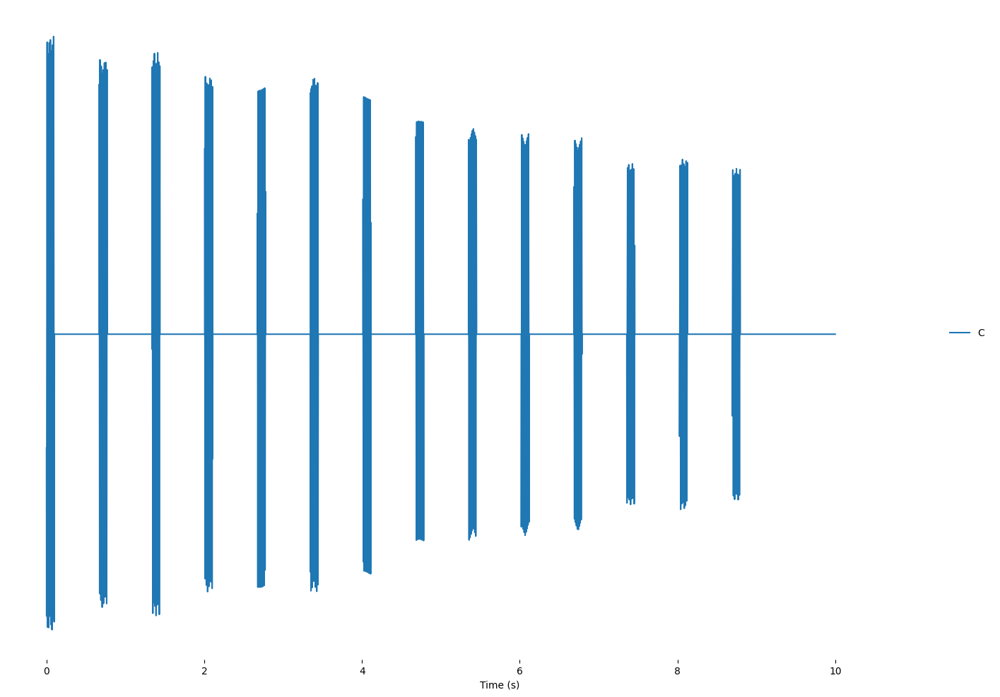

In [22]:
#pre-coded example of discrete in time, can edit accordingly
# length of the sonification in seconds
length = 10

notes = [["C2", "E2", "G2", "B2", "D2"]] #what notes do you want? Do you want a chord? They will play in the order you type them!
score =  Score(notes, length) #setting up the score, nothing too exciting here


data = {'pitch':pm25['Data Value'].values/np.max(pm25['Data Value']), 
        'volume':pm25['Data Value'].values/np.max(pm25['Data Value']),
        'time':np.linspace(0, 1, len(pm25['Data Value']))} 

maplims =  {'time': ('0', '115')} #time limits - needs to be a bit over 100 so that the final note can finish out

# doing the actual sonification!
sources = Events(data.keys()) 
sources.fromdict(data)
sources.apply_mapping_functions(map_lims=maplims)

soni = Sonification(score, sources, gen3, system)
soni.render()
plt.figure()
soni.notebook_display()

<Figure size 640x480 with 0 Axes>

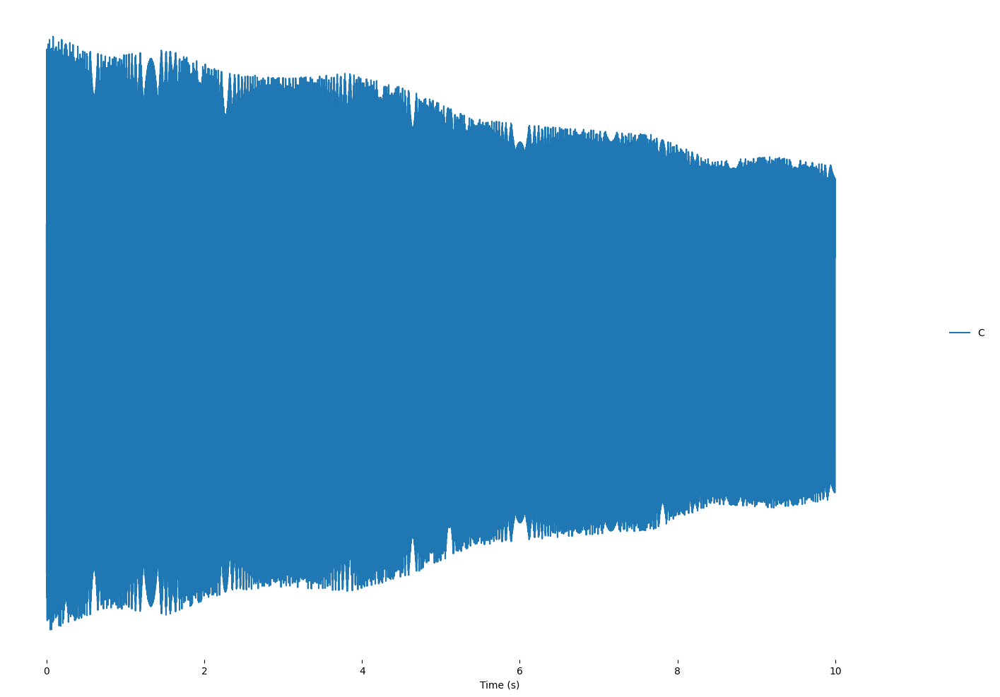

In [23]:
#pre-coded example of continuous in time, can edit accordingly
# length of the sonification in seconds
length = 10

notes = [["C2", "E2", "G2", "B2", "D2"]] #what notes do you want? Do you want a chord?
score =  Score(notes, length) #setting up the score, nothing too exciting here


data = {'pitch_shift':pm25['Data Value'].values/np.max(pm25['Data Value']), 
        'pitch':1,
        'volume':pm25['Data Value'].values/np.max(pm25['Data Value']),
        'time_evo':np.linspace(0,1,len(pm25['Data Value']))} 

maplims =  {'time': ('0', '115')} #time limits - needs to be a bit over 100 so that the final note can finish out

# doing the actual sonification!
sources = Objects(data.keys()) 
sources.fromdict(data)
sources.apply_mapping_functions(map_lims=maplims)

soni = Sonification(score, sources, gen3, system)
soni.render()
plt.figure()
soni.notebook_display()

# Let's try another data set!

In [24]:
import scipy.io
heart = scipy.io.loadmat('JS00001.mat')
heart['val'].shape

(12, 5000)

## This data set is real electrocardiogram (ECG) heart data for an adult man. This ECG is NOT that of a normal, healthy heart -- this ECG showcases atrial fibrillation, right bundle branch block, and T wave Change. The data is for twelve 'leads' taken over ten seconds, where the x-axis is time and the y-axis is amplitude in millivolts. Each lead records electrical activity in different regions of the heart

Data from: https://www.physionet.org/content/ecg-arrhythmia/1.0.0/

Zheng, J., Guo, H., & Chu, H. (2022). A large scale 12-lead electrocardiogram database for arrhythmia study (version 1.0.0). PhysioNet. https://doi.org/10.13026/wgex-er52.

Zheng, J., Chu, H., Struppa, D., Zhang, J., Yacoub, S.M., El-Askary, H., Chang, A., Ehwerhemuepha, L., Abudayyeh, I., Barrett, A.S., Fu, G., Yao, H., Li, D., Guo, H., & Rakovski, C. (2020). Optimal Multi-Stage Arrhythmia Classification Approach. Scientific Reports, 10.

Goldberger, A., Amaral, L., Glass, L., Hausdorff, J., Ivanov, P. C., Mark, R., ... & Stanley, H. E. (2000). PhysioBank, PhysioToolkit, and PhysioNet: Components of a new research resource for complex physiologic signals. Circulation [Online]. 101 (23), pp. e215–e220.

# Let's start by plotting the data:

[Text(0.5, 0, 'Time'), Text(0, 0.5, 'Amplitude (millivolts)')]

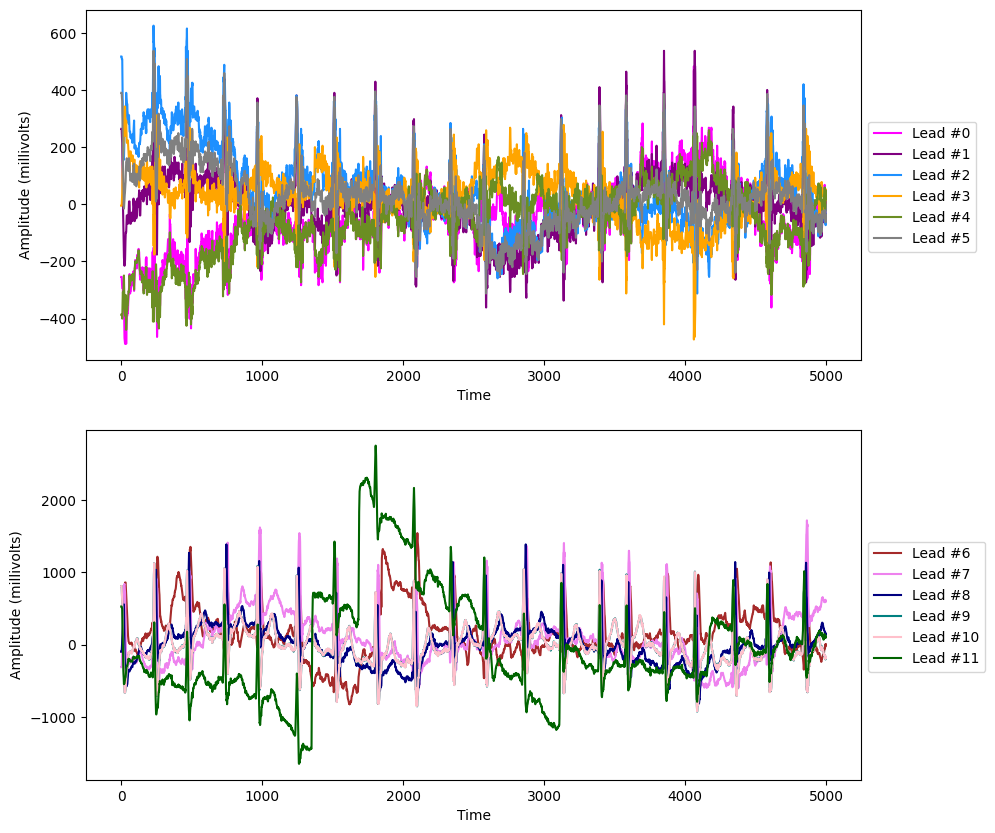

In [26]:
colors = ['magenta', 'purple', 'dodgerblue', 'orange', 'olivedrab', 'grey', 'brown', 'violet', 'navy', 'teal', 'pink', 'darkgreen']
fig, (ax) = plt.subplot_mosaic([['A'], ['B']], figsize=(10,10))
for lead in range(heart['val'].shape[0]):
    if lead < 6:
        ax['A'].plot(np.arange(0,len(heart['val'][lead,:]), 1), heart['val'][lead,:],c=colors[lead], label='Lead #'+str(lead))
    else:
        ax['B'].plot(np.arange(0,len(heart['val'][lead,:]), 1), heart['val'][lead,:],c=colors[lead], label='Lead #'+str(lead))
ax['A'].legend(bbox_to_anchor=[1.,.7,0,0])
ax['A'].set(xlabel='Time', ylabel='Amplitude (millivolts)')
ax['B'].legend(bbox_to_anchor=[1.,.7,0,0])
ax['B'].set(xlabel='Time', ylabel='Amplitude (millivolts)')

# Now let's sonify! Choices to make:
- Which lead do you want to start with?
- instrument vs synth (timbre)
- mapping pitch vs volume
- discrete vs continuous
- the note (or chord) to be modulated

<Figure size 640x480 with 0 Axes>

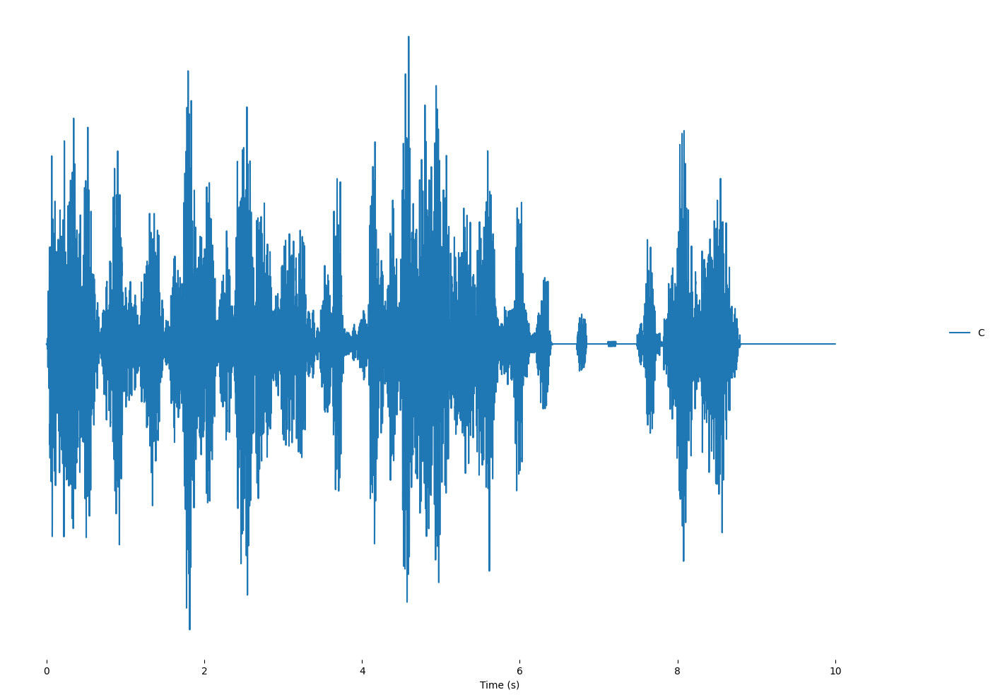

In [28]:
#pre-coded example of discrete in time, can edit accordingly
# length of the sonification in seconds
system = 'mono'
length = 10
lead = 3

notes = [["C2", "E2", "G2", "B2", "D2"]] #what notes do you want? Do you want a chord? They will play in the order you type them!
score =  Score(notes, length) #setting up the score, nothing too exciting here


data = {'pitch':heart['val'][lead,:]/np.max(heart['val'][lead,:]), 
        'volume':heart['val'][lead,:]/np.max(heart['val'][lead,:]),
        'time':np.linspace(0, 1, len(heart['val'][lead,:]))} 

maplims =  {'time': ('0%', '115%')} #time limits - needs to be a bit over 100 so that the final note can finish out

# doing the actual sonification!
sources = Events(data.keys()) 
sources.fromdict(data)
sources.apply_mapping_functions(map_lims=maplims)

soni = Sonification(score, sources, gen3, system)
soni.render()
plt.figure()
soni.notebook_display()

<Figure size 640x480 with 0 Axes>

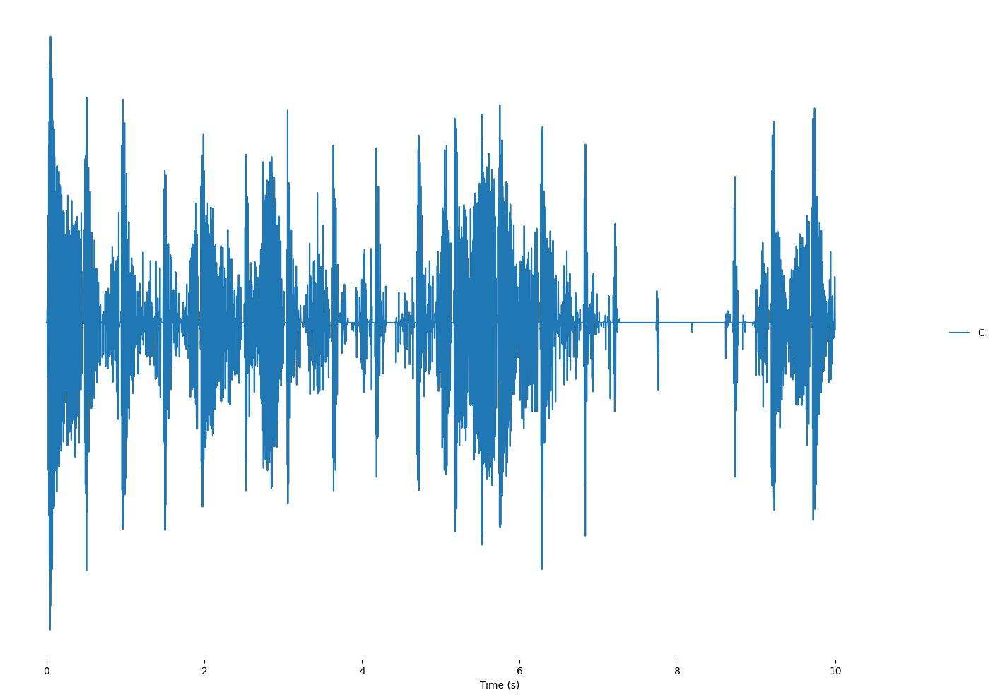

In [30]:
#pre-coded example of continuous in time, can edit accordingly
# length of the sonification in seconds
length = 10
lead = 3

notes = [["C2", "E2", "G2", "B2", "D2"]] #what notes do you want? Do you want a chord?
score =  Score(notes, length) #setting up the score, nothing too exciting here


data = {'pitch_shift':heart['val'][lead,:]/np.max(heart['val'][lead,:]), 
        'pitch':1,
        'volume':heart['val'][lead,:]/np.max(heart['val'][lead,:]),
        'time_evo':np.linspace(0,1,len(heart['val'][lead,:]))} 

maplims =  {'time': ('0%', '115%')} #time limits - needs to be a bit over 100 so that the final note can finish out

# doing the actual sonification!
sources = Objects(data.keys()) 
sources.fromdict(data)
sources.apply_mapping_functions(map_lims=maplims)

soni = Sonification(score, sources, gen3, system)
soni.render()
plt.figure()
soni.notebook_display()